# Scenario-3: Toronto Rookies

**The National Basketball Association (NBA) is a men's professional basketball league in North America, composed of 30 teams. It is one of the four major sports leagues in USA Canada. The NBA is an active member of USA Basketball (USAB), which is recognized by FIBA (also known as the International Basketball Federation) as the national governing body for basketball in the United States.**

### Problem Statement:

The data contains the details of NBA rookies who have recently been part of NBA. We have to classify the career longevity of NBA rookies more than 5 years or not.

**Dataset Description:**

****Attributes:****

The dataset has details of NBA rookies along with their career longevity either more than 5 years or not

* Name: Name of the players

* GP: Games played

* MIN: Total minutes played

* PTS: Points per game

* FGM: Field goals made

* FGA: Field goals attempted

* FG%: Field goals percent

* 3P Made: 3 Points made

* 3PA: 3 Points attempted

- 3P%: 3 Points percentage

* FTM: Free throw made

* FTA: Free throw attempted

- FT%: Free throw percentage

* OREB: Offensive rebounds

* DREB: Defensive rebounds

* REB: Rebounds

* AST: Assists

* STL: Steals

* BLK: Blocks

* TOV: Tumovers

**Target Variable:**

* TARGET_5Yrs: 0 if career years played 5 | 1 if career years played >= 5



### Tasks to be Performed:

In order to attain the above goal below tasks must be performed:

* Read the dataset and pre-process the data. - **Beginner**

* Split the data into training and testing set, Apply Gaussian Naive Bayes and Decision Tree over the model. - **Intermediate**

* Evaluate the models using confusion matrix. - **Intermediate**

* Apply XGBoost Classifier over the data and evaluate the model - **Advanced**

* Apply GridSearchCV over XGboost Classifier. **Advanced**

**Topics Covered:**

* XGBoost

* GridSearchCV

* Decision Tree

* Naive Bayes

# Question-1: Read the dataset and pre-process the data.

In [10]:
import pandas as pd
import numpy as np

In [11]:
df = pd.read_csv('nba_logreg.csv')
df

,name,gp,min,pts,fgm,fga,fg,3p_made,3pa,3p,...,fta,ft,oreb,dreb,reb,ast,stl,blk,tov,target_5yrs
0,Brandon Ingram,36,27.4,7.4,2.6,7.6,34.7,0.5,2.1,25.0,...,2.3,69.9,0.7,3.4,4.1,1.9,0.4,0.4,1.3,0.0
1,Andrew Harrison,35,26.9,7.2,2.0,6.7,29.6,0.7,2.8,23.5,...,3.4,76.5,0.5,2.0,2.4,3.7,1.1,0.5,1.6,0.0
2,JaKarr Sampson,74,15.3,5.2,2.0,4.7,42.2,0.4,1.7,24.4,...,1.3,67.0,0.5,1.7,2.2,1.0,0.5,0.3,1.0,0.0
3,Malik Sealy,58,11.6,5.7,2.3,5.5,42.6,0.1,0.5,22.6,...,1.3,68.9,1.0,0.9,1.9,0.8,0.6,0.1,1.0,1.0
4,Matt Geiger,48,11.5,4.5,1.6,3.0,52.4,0.0,0.1,0.0,...,1.9,67.4,1.0,1.5,2.5,0.3,0.3,0.4,0.8,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1335,Chris Smith,80,15.8,4.3,1.6,3.6,43.3,0.0,0.2,14.3,...,1.5,79.2,0.4,0.8,1.2,2.5,0.6,0.2,0.8,0.0
1336,Brent Price,68,12.6,3.9,1.5,4.1,35.8,0.1,0.7,16.7,...,1.0,79.4,0.4,1.1,1.5,2.3,0.8,0.0,1.3,1.0
1337,Marlon Maxey,43,12.1,5.4,2.2,3.9,55.0,0.0,0.0,0.0,...,1.6,64.3,1.5,2.3,3.8,0.3,0.3,0.4,0.9,0.0
1338,Litterial Green,52,12.0,4.5,1.7,3.8,43.9,0.0,0.2,10.0,...,1.8,62.5,0.2,0.4,0.7,2.2,0.4,0.1,0.8,1.0


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1340 entries, 0 to 1339
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   name         1340 non-null   object 
 1   gp           1340 non-null   int64  
 2   min          1340 non-null   float64
 3   pts          1340 non-null   float64
 4   fgm          1340 non-null   float64
 5   fga          1340 non-null   float64
 6   fg           1340 non-null   float64
 7   3p_made      1340 non-null   float64
 8   3pa          1340 non-null   float64
 9   3p           1329 non-null   float64
 10  ftm          1340 non-null   float64
 11  fta          1340 non-null   float64
 12  ft           1340 non-null   float64
 13  oreb         1340 non-null   float64
 14  dreb         1340 non-null   float64
 15  reb          1340 non-null   float64
 16  ast          1340 non-null   float64
 17  stl          1340 non-null   float64
 18  blk          1340 non-null   float64
 19  tov   

In [13]:
df.describe(include='all')

,name,gp,min,pts,fgm,fga,fg,3p_made,3pa,3p,...,fta,ft,oreb,dreb,reb,ast,stl,blk,tov,target_5yrs
count,1340,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1329.000000,...,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000,1340.000000
unique,1294,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Charles Smith,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,60.414179,17.624627,6.801493,2.629104,5.885299,44.169403,0.247612,0.779179,19.308126,...,1.821940,70.300299,1.009403,2.025746,3.034478,1.550522,0.618507,0.368582,1.193582,0.620149
std,NaN,17.433992,8.307964,4.357545,1.683555,3.593488,6.137679,0.383688,1.061847,16.022916,...,1.322984,10.578479,0.777119,1.360008,2.057774,1.471169,0.409759,0.429049,0.722541,0.485531
min,NaN,11.000000,3.100000,0.700000,0.300000,0.800000,23.800000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.200000,0.300000,0.000000,0.000000,0.000000,0.100000,0.000000
25%,NaN,47.000000,10.875000,3.700000,1.400000,3.300000,40.200000,0.000000,0.000000,0.000000,...,0.900000,64.700000,0.400000,1.000000,1.500000,0.600000,0.300000,0.100000,0.700000,0.000000
50%,NaN,63.000000,16.100000,5.550000,2.100000,4.800000,44.100000,0.100000,0.300000,22.400000,...,1.500000,71.250000,0.800000,1.700000,2.500000,1.100000,0.500000,0.200000,1.000000,1.000000
75%,NaN,77.000000,22.900000,8.800000,3.400000,7.500000,47.900000,0.400000,1.200000,32.500000,...,2.300000,77.600000,1.400000,2.600000,4.000000,2.000000,0.800000,0.500000,1.500000,1.000000


In [16]:
import seaborn as sns
import matplotlib.pyplot as plt
df.corr()

,gp,min,pts,fgm,fga,fg,3p_made,3pa,3p,ftm,fta,ft,oreb,dreb,reb,ast,stl,blk,tov,target_5yrs
gp,1.000000,0.590240,0.538471,0.542724,0.516625,0.296289,0.107423,0.098772,0.038209,0.482123,0.479487,0.196299,0.401136,0.466840,0.460406,0.372749,0.451137,0.276498,0.518167,0.396833
min,0.590240,1.000000,0.911822,0.903060,0.910247,0.203901,0.389920,0.403258,0.165997,0.791000,0.779609,0.239878,0.573062,0.745513,0.709707,0.629015,0.757034,0.399088,0.826500,0.317805
pts,0.538471,0.911822,1.000000,0.990834,0.979733,0.255333,0.346682,0.356751,0.151072,0.896297,0.880703,0.258931,0.575106,0.693934,0.676849,0.552338,0.675341,0.387043,0.850366,0.315981
fgm,0.542724,0.903060,0.990834,1.000000,0.980050,0.291693,0.289007,0.299057,0.119493,0.848019,0.840408,0.223566,0.596687,0.703278,0.691186,0.532534,0.662640,0.398125,0.834352,0.317594
fga,0.516625,0.910247,0.979733,0.980050,1.000000,0.129798,0.390253,0.413560,0.197160,0.826616,0.805559,0.269614,0.504212,0.640123,0.614328,0.589818,0.690168,0.322184,0.845989,0.292660
fg,0.296289,0.203901,0.255333,0.291693,0.129798,1.000000,-0.294471,-0.350658,-0.330690,0.245776,0.300154,-0.161183,0.511367,0.410555,0.465423,-0.108797,0.056658,0.391626,0.121806,0.227134
3p_made,0.107423,0.389920,0.346682,0.289007,0.390253,-0.294471,1.000000,0.982616,0.589855,0.158472,0.095396,0.314355,-0.219010,0.016570,-0.072503,0.376604,0.306908,-0.158535,0.258369,0.036619
3pa,0.098772,0.403258,0.356751,0.299057,0.413560,-0.350658,0.982616,1.000000,0.582337,0.173533,0.108388,0.323612,-0.231897,0.011226,-0.080939,0.410531,0.338631,-0.172150,0.283925,0.018110
3p,0.038209,0.165997,0.151072,0.119493,0.197160,-0.330690,0.589855,0.582337,1.000000,0.030320,-0.032333,0.326372,-0.288759,-0.122949,-0.191071,0.262120,0.194329,-0.242274,0.108277,-0.003411
ftm,0.482123,0.791000,0.896297,0.848019,0.826616,0.245776,0.158472,0.173533,0.030320,1.000000,0.980505,0.257818,0.583865,0.653823,0.653833,0.476214,0.600158,0.407466,0.804990,0.296841


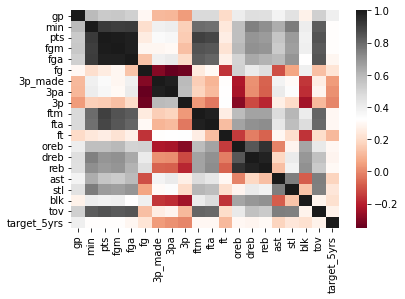

In [18]:
sns.heatmap(df.corr(),cmap='RdGy')
plt.show()

* min column is highly correlated with pts,fga,fgm
* ftm and fta columns are highly correlated

In [19]:
miss = pd.DataFrame({'Col_name':df.columns,
                     'Missing value?':[any(df[x].isnull()) for x in df.columns],
                     'Count':[sum(df[y].isnull()) for y in df.columns],
                     'percentage':[sum(df[y].isnull())/df.shape[0] for y in df.columns]
                    })
miss.sort_values(by='Count',ascending=False)

,Col_name,Missing value?,Count,percentage
9,3p,True,11,0.008209
0,name,False,0,0.000000
11,fta,False,0,0.000000
19,tov,False,0,0.000000
18,blk,False,0,0.000000
17,stl,False,0,0.000000
16,ast,False,0,0.000000
15,reb,False,0,0.000000
14,dreb,False,0,0.000000
13,oreb,False,0,0.000000


In [20]:
df['3p'].fillna(df['3p'].mean(),inplace=True)

In [21]:
miss = pd.DataFrame({'Col_name':df.columns,
                     'Missing value?':[any(df[x].isnull()) for x in df.columns],
                     'Count':[sum(df[y].isnull()) for y in df.columns],
                     'percentage':[sum(df[y].isnull())/df.shape[0] for y in df.columns]
                    })
miss.sort_values(by='Count',ascending=False)

,Col_name,Missing value?,Count,percentage
0,name,False,0,0.0
11,fta,False,0,0.0
19,tov,False,0,0.0
18,blk,False,0,0.0
17,stl,False,0,0.0
16,ast,False,0,0.0
15,reb,False,0,0.0
14,dreb,False,0,0.0
13,oreb,False,0,0.0
12,ft,False,0,0.0


#  pre-processing the data

In [24]:
target_ratio=pd.DataFrame({'Counts':df.target_5yrs.value_counts(),
                          'Percentage':df.target_5yrs.value_counts()/len(df)})
target_ratio

,Counts,Percentage
1.0,831,0.620149
0.0,509,0.379851


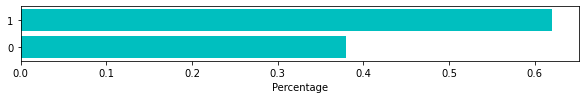

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,1))
plt.barh(target_ratio.index,target_ratio.Percentage,color='c')
plt.xlabel('Percentage')
plt.show()

In [26]:
#let's Use pandas profiling over the dataset to generate a report
from pandas_profiling import ProfileReport
profileReport = ProfileReport(df,title ="Toronto Rookies data Analysis")
profileReport

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Question-2: Split the data into training and testing set, Apply Gaussian Naive Bayes and Decision Tree over the model.

In [27]:
feat=df.columns

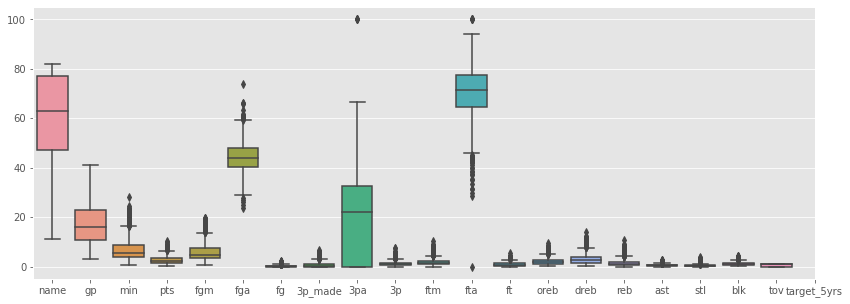

In [29]:
# Before splitting Let's see the data distribution.
plt.style.use('ggplot')
plt.figure(figsize=(14,5))
sns.boxplot(data=df)
plt.xticks(ticks=np.arange(len(feat)),labels=feat)
plt.show()

In [30]:
df.shape

(1340, 21)

In [31]:
# Removing outliers
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)
data_o = df[~((df < (Q1 - 1.5*IQR)) | (df > (Q3 + 1.5*IQR))).any(axis=1)]

gp             30.000
min            12.025
pts             5.100
fgm             2.000
fga             4.200
fg              7.700
3p_made         0.400
3pa             1.200
3p             32.500
ftm             1.000
fta             1.400
ft             12.900
oreb            1.000
dreb            1.600
reb             2.500
ast             1.400
stl             0.500
blk             0.400
tov             0.800
target_5yrs     1.000
dtype: float64


C:\Users\jack\AppData\Local\Temp/ipykernel_11588/2903748522.py:6: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  data_o = df[~((df < (Q1 - 1.5*IQR)) | (df > (Q3 + 1.5*IQR))).any(axis=1)]


In [32]:
data_o.shape

(991, 21)

Data is highly unbalanced.

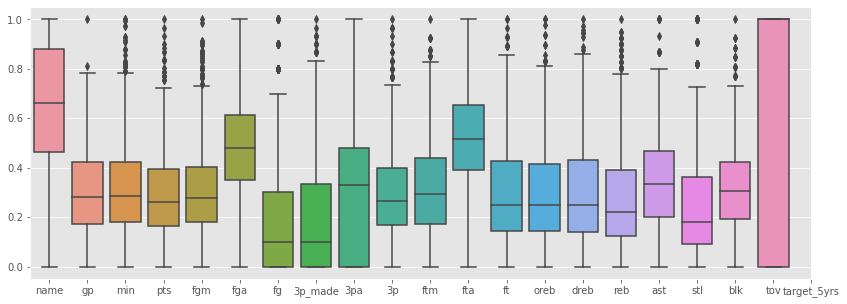

In [35]:
# Scaling data after outlier removal
from sklearn.preprocessing import MinMaxScaler
scl=MinMaxScaler()
scl_data=scl.fit_transform(data_o.drop('name',axis=1))
plt.style.use('ggplot')
plt.figure(figsize=(14,5))
sns.boxplot(data=scl_data)
plt.xticks(ticks=np.arange(len(feat)),labels=feat)
plt.show()

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier

In [37]:
X = scl_data[:,:19]
y = scl_data[:,19]
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7,test_size=0.3,random_state=101)

In [38]:
gnb=GaussianNB()
gnb.fit(X_train,y_train)
g_pred=gnb.predict(X_test)

In [39]:
dt=DecisionTreeClassifier()
dt.fit(X_train,y_train)
d_pred=dt.predict(X_test)

In [40]:
# Let's Try using RandomForest
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train,y_train)
r_pred=rf.predict(X_test)

In [41]:
# Let's try using Logistic Model as well as
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr.fit(X_train,y_train)
l_pred=lr.predict(X_test)

# Question-3: Evaluate the models using confusion matrix.

In [43]:
from sklearn.metrics import accuracy_score, confusion_matrix
print('The accuracy of the Gaussian Naive Bayes model is:',round(accuracy_score(y_test,g_pred)*100,2))
print('The accuracy of the Decision Tree model is:',round(accuracy_score(y_test,d_pred)*100,2))
print('The accuracy of the Random Forest model is:',round(accuracy_score(y_test,r_pred)*100,2))
print('The accuracy of the Logistic Regressor model is:',round(accuracy_score(y_test,l_pred)*100,2))

The accuracy of the Gaussian Naive Bayes model is: 59.73
The accuracy of the Decision Tree model is: 59.73
The accuracy of the Random Forest model is: 65.44
The accuracy of the Logistic Regressor model is: 68.46


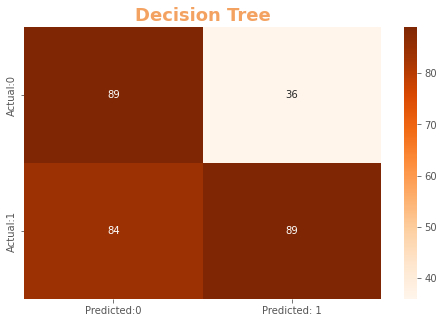

In [44]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,d_pred)
conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted: 1'], 
                          index=['Actual:0', 'Actual:1']) 
plt.figure(figsize=(8,5)) 
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Oranges') 
fm={'size' :18, 'color': '#f4a261', 'weight':'bold'} 
plt.title('Decision Tree', **fm) 
plt.show()

In [46]:
TN=cm[0,0]
TP=cm[1,1]
FN=cm[1,0]
FP=cm[0,1]
sensitivity=TP/float(TP+FN)
specificity=TN/float(TN+FP)
print("True Negative", TN) 
print("True Positive", TP)
print("False Negative", FN)
print("False Positive", FP)
print("Sensitivity", sensitivity)
print("Specificity", specificity) 

True Negative 89
True Positive 89
False Negative 84
False Positive 36
Sensitivity 0.5144508670520231
Specificity 0.712


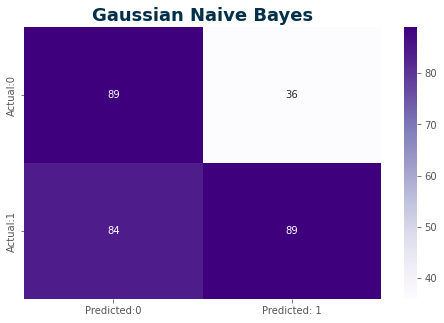

In [48]:
cm = confusion_matrix(y_test,g_pred)
conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted: 1'], 
                          index=['Actual:0', 'Actual:1']) 
plt.figure(figsize=(8,5)) 
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples') 
fm={'size' :18, 'color': '#003049', 'weight':'bold'} 
plt.title('Gaussian Naive Bayes', **fm) 
plt.show()

In [49]:
TN=cm[0,0]
TP=cm[1,1]
FN=cm[1,0]
FP=cm[0,1]
sensitivity=TP/float(TP+FN)
specificity=TN/float(TN+FP)
print("True Negative", TN) 
print("True Positive", TP)
print("False Negative", FN)
print("False Positive", FP)
print("Sensitivity", sensitivity)
print("Specificity", specificity) 

True Negative 89
True Positive 89
False Negative 84
False Positive 36
Sensitivity 0.5144508670520231
Specificity 0.712


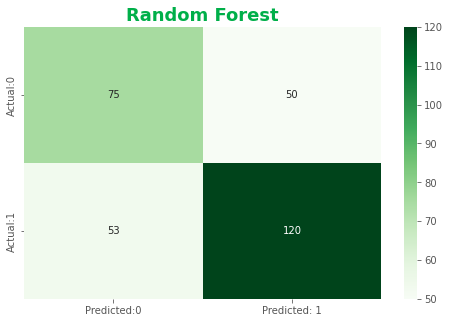

In [50]:
cm = confusion_matrix(y_test,r_pred)
conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted: 1'], 
                          index=['Actual:0', 'Actual:1']) 
plt.figure(figsize=(8,5)) 
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Greens') 
fm={'size' :18, 'color': '#00af49', 'weight':'bold'} 
plt.title('Random Forest', **fm) 
plt.show()

In [51]:
TN=cm[0,0]
TP=cm[1,1]
FN=cm[1,0]
FP=cm[0,1]
sensitivity=TP/float(TP+FN)
specificity=TN/float(TN+FP)
print("True Negative", TN) 
print("True Positive", TP)
print("False Negative", FN)
print("False Positive", FP)
print("Sensitivity", sensitivity)
print("Specificity", specificity) 

True Negative 75
True Positive 120
False Negative 53
False Positive 50
Sensitivity 0.6936416184971098
Specificity 0.6


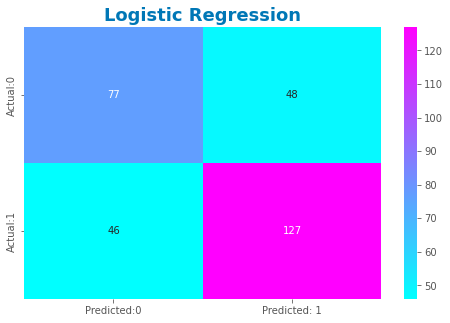

In [52]:
cm = confusion_matrix(y_test,l_pred)
conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted: 1'], 
                          index=['Actual:0', 'Actual:1']) 
plt.figure(figsize=(8,5)) 
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='cool') 
fm={'size' :18, 'color': '#0077B6', 'weight':'bold'} 
plt.title('Logistic Regression', **fm) 
plt.show()

In [53]:
TN=cm[0,0]
TP=cm[1,1]
FN=cm[1,0]
FP=cm[0,1]
sensitivity=TP/float(TP+FN)
specificity=TN/float(TN+FP)
print("True Negative", TN) 
print("True Positive", TP)
print("False Negative", FN)
print("False Positive", FP)
print("Sensitivity", sensitivity)
print("Specificity", specificity) 

True Negative 77
True Positive 127
False Negative 46
False Positive 48
Sensitivity 0.7341040462427746
Specificity 0.616


In [54]:
from sklearn.metrics import precision_score, classification_report,f1_score, recall_score

In [55]:
print("\t\tClassification Report for Gaussian Naive Bayes Model") 
print(classification_report(y_test,g_pred))

		Classification Report for Gaussian Naive Bayes Model
              precision    recall  f1-score   support

         0.0       0.51      0.71      0.60       125
         1.0       0.71      0.51      0.60       173

    accuracy                           0.60       298
   macro avg       0.61      0.61      0.60       298
weighted avg       0.63      0.60      0.60       298



In [56]:
print("\t\tClassification Report for Decision Tree Model") 
print(classification_report(y_test,d_pred))

		Classification Report for Decision Tree Model
              precision    recall  f1-score   support

         0.0       0.51      0.71      0.60       125
         1.0       0.71      0.51      0.60       173

    accuracy                           0.60       298
   macro avg       0.61      0.61      0.60       298
weighted avg       0.63      0.60      0.60       298



In [57]:
print("\t\tClassification Report for Random Forest Model") 
print(classification_report(y_test,r_pred))

		Classification Report for Random Forest Model
              precision    recall  f1-score   support

         0.0       0.59      0.60      0.59       125
         1.0       0.71      0.69      0.70       173

    accuracy                           0.65       298
   macro avg       0.65      0.65      0.65       298
weighted avg       0.66      0.65      0.65       298



In [58]:
print("\t\tClassification Report for Logistic Model") 
print(classification_report(y_test,l_pred))

		Classification Report for Logistic Model
              precision    recall  f1-score   support

         0.0       0.63      0.62      0.62       125
         1.0       0.73      0.73      0.73       173

    accuracy                           0.68       298
   macro avg       0.68      0.68      0.68       298
weighted avg       0.68      0.68      0.68       298



In [59]:
# Let's see precision and recall values
# Initialize the evaluation dictionary
def initialize_evaluator():
    return {'Model':[],'Accuracy':[],'Precision':[],'Recall':[],'F1_score':[]}

# Insert data in evaluation dictionary
def insert_data(test,pred,model):
    eval_data=initialize_evaluator()
    eval_data['Model'].append(model)
    eval_data['Accuracy'].append(accuracy_score(test,pred))
    eval_data['Precision'].append(precision_score(test,pred))
    eval_data['Recall'].append(recall_score(test,pred))
    eval_data['F1_score'].append(f1_score(test,pred))
    return eval_data

# Append data of one dictionary to another 
def append_data(data1,data2):
    for i in data1.keys():
        data2[i].extend(data1[i])
    return data2
    

In [61]:
eval_g=insert_data(y_test,g_pred, 'Gaussian Naive Bayes')
eval_dt=insert_data(y_test, d_pred, 'Decision Tree')
eval_rf=insert_data(y_test, r_pred, 'Random Forest')
eval_l=insert_data(y_test,l_pred, 'Logistic Regression')  
eval_all=append_data(eval_l,eval_g)
eval_all=append_data(eval_rf, eval_all)
eval_all=append_data(eval_dt, eval_all)

In [63]:
# Let's Plot the model
from matplotlib.gridspec import GridSpec
def plot_models(data):
    sns.set_palette(sns.color_palette("rocket"))
    super_title={'size':18, 'color':'#c5283d', 'weight':'bold'} 
    sub_title={'size':12, 'color':'#e06777', 'weight':'bold'}
    colors=np.array([[156, 137, 184], [239, 195, 230], [184, 190, 221], [231, 115, 171]])
    colors=colors/255 #Matplotlib RGB color range is from: 0-1
    data=pd.DataFrame(data) 
    fig = plt.figure(figsize=(10,7), constrained_layout=True) 
    gs= GridSpec(2, 2, figure=fig)
    ax1 = fig.add_subplot(gs[0, 0])
    ax1.barh(data.Model, data.Accuracy, color=colors)
    ax1.tick_params(labelbottom=False, labelleft=True)
    ax1.set_xlim(0,1)
    ax1.set_title('Accuracy', **sub_title)
    ax2 = fig.add_subplot(gs[0, 1])
    ax2.barh(data.Model, data.Precision, color=colors)
    ax2.tick_params(labelbottom=False, labelleft=False)
    ax2.set_xlim(0,1)
    ax2.set_title('Precision', **sub_title)
    ax3 =fig.add_subplot(gs[1, 0]) 
    ax3.barh(data.Model, data.Recall, color=colors)
    ax3.tick_params(labelbottom=True, labelleft=True)
    ax3.set_xlim(0,1)
    ax3.set_title('Recall', **sub_title)
    ax4=fig.add_subplot(gs[1, 1])
    ax4.barh(data.Model, data.F1_score, color=colors)
    ax4.tick_params(labelbottom=False, labelleft=False)
    ax4.set_xlim(0,1)
    ax4.set_title('F1 Score',**sub_title)
    fig.suptitle("Evaluation",**super_title)
    ax4.tick_params(labelbottom=True, labelleft=False) 
    plt.show()

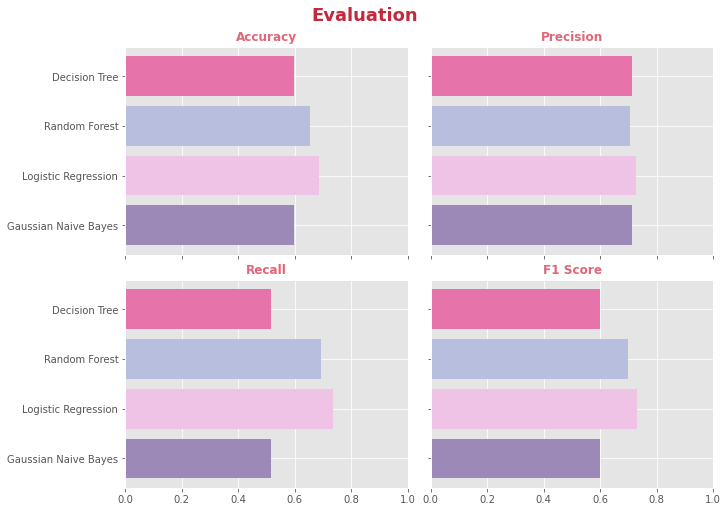

In [64]:
plot_models(eval_all)

**Conclusion:** From the above graph we can see that logistic regression is performing fairly well enough.

# Question-4: Apply XGBoost Classifier over the data and evaluate the model.

In [65]:
from xgboost import XGBClassifier

In [90]:
xb_clf= XGBClassifier(learning_rate=0.65,n_estimators=1000)
xb_clf.fit(X_train,y_train)
xb_pred=xb_clf.predict(X_test)

In [67]:
print('The accuracy of the XGBoost model is:',round(accuracy_score(y_test,xb_pred)*100,2))

The accuracy of the XGBoost model is: 62.08


In [68]:
print("\t\tClassification Report for XGBoost Model") 
print(classification_report(y_test,xb_pred))

		Classification Report for XGBoost Model
              precision    recall  f1-score   support

         0.0       0.55      0.51      0.53       125
         1.0       0.66      0.70      0.68       173

    accuracy                           0.62       298
   macro avg       0.61      0.61      0.61       298
weighted avg       0.62      0.62      0.62       298



# Question-5: Apply GridSearchCV over XGBoost Classifier.

In [69]:
from sklearn.model_selection import GridSearchCV
import warnings
warnings.filterwarnings("ignore")

In [70]:
params={'learning_rate':[0.65,0.70,0.75],'n_estimators':[100,1000]}
rf_gsv=GridSearchCV(estimator=XGBClassifier(),param_grid=params,cv=3,scoring='accuracy')
rf_gsv.fit(X_train,y_train)

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     gamma=None, gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_bin=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
    

In [72]:
pd.DataFrame(rf_gsv.cv_results_).sort_values('rank_test_score')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
5,1.531258,0.010486,0.007680,0.006567,0.75,1000,"{'learning_rate': 0.75, 'n_estimators': 1000}",0.601732,0.649351,0.640693,0.630592,0.020711,1
0,0.201197,0.011886,0.003382,0.004783,0.65,100,"{'learning_rate': 0.65, 'n_estimators': 100}",0.610390,0.640693,0.627706,0.626263,0.012413,2
1,1.588647,0.074082,0.015626,0.000001,0.65,1000,"{'learning_rate': 0.65, 'n_estimators': 1000}",0.597403,0.636364,0.645022,0.626263,0.020711,2
4,0.186188,0.003881,0.005209,0.007367,0.75,100,"{'learning_rate': 0.75, 'n_estimators': 100}",0.593074,0.601732,0.649351,0.614719,0.024742,4
2,0.186763,0.002071,0.005385,0.007616,0.7,100,"{'learning_rate': 0.7, 'n_estimators': 100}",0.588745,0.627706,0.623377,0.613276,0.017436,5
3,1.534956,0.013148,0.007540,0.006390,0.7,1000,"{'learning_rate': 0.7, 'n_estimators': 1000}",0.580087,0.627706,0.627706,0.611833,0.022448,6


In [73]:
cvr=pd.DataFrame(rf_gsv.cv_results_)

In [74]:
rf_gsv.best_params_

{'learning_rate': 0.75, 'n_estimators': 1000}

In [75]:
rf_gsv.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.75, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=1000,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)

In [88]:
# KDE Plots
def format_text(size, color, weight='heavy'): 
    return {'size':size, 'color': '#'+color, 'weight':weight}

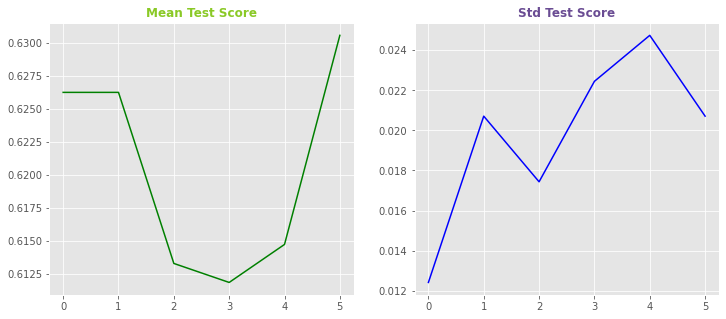

In [89]:
from matplotlib.gridspec import GridSpec
fig=plt.figure(figsize=(12,5))
gs=GridSpec(1,2,fig)
ax1=fig.add_subplot(gs[0,0])
ax1.plot(cvr.mean_test_score,c='g')
ax1.set_title('Mean Test Score',**format_text(12,'8AC926'))
ax2=fig.add_subplot(gs[0,1])
ax2.plot(cvr.std_test_score,c='b')
ax2.set_title('Std Test Score',**format_text(12,'6A4C93'))
plt.show()

**Model_O has lost deviation as well as High accuracy.**